Active and Semi-Supervised Learning
=============================

In [3]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_context('poster')
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels \
    import RBF, WhiteKernel, RationalQuadratic, ExpSineSquared, Matern

# Active Learning under No Noise
Compare the number of training samples and the Mean Squared Error across the Uncertainty Sampling and Random conditions:

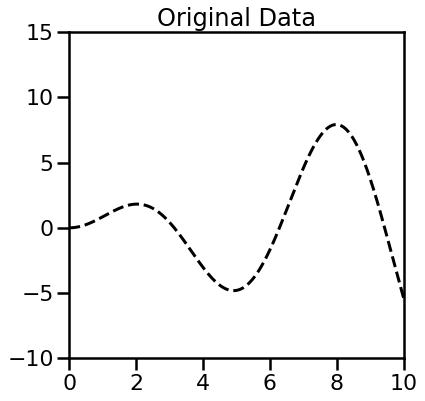

In [4]:
np.random.seed(5)  # Set random seed so that we see the same thing

# Define a function to generate samples
# Feel free to add your own or change things
def f(x):
    """The function to predict."""
    return x * np.sin(x)
    # Try others!
    #return 5 * np.sinc(x)
    #return x

# This generates points we will pick from during the active learning
X = np.atleast_2d(np.linspace(0, 10, 200)).T

# Observations at each of the possible points
# (We will only observe a subset of these)
y = f(X).ravel()


# Generate points for plotting the predicted function
x = np.atleast_2d(np.linspace(0, 10, 1000)).T

plt.figure(figsize=(6,6))
# Plot the original function
plt.plot(x,f(x),'k--',alpha=1)
plt.ylim([-10,15]) # Set the y-axis limits
plt.xlim([0,10])   # Set the x-axis limits
plt.title("Original Data")
plt.show()

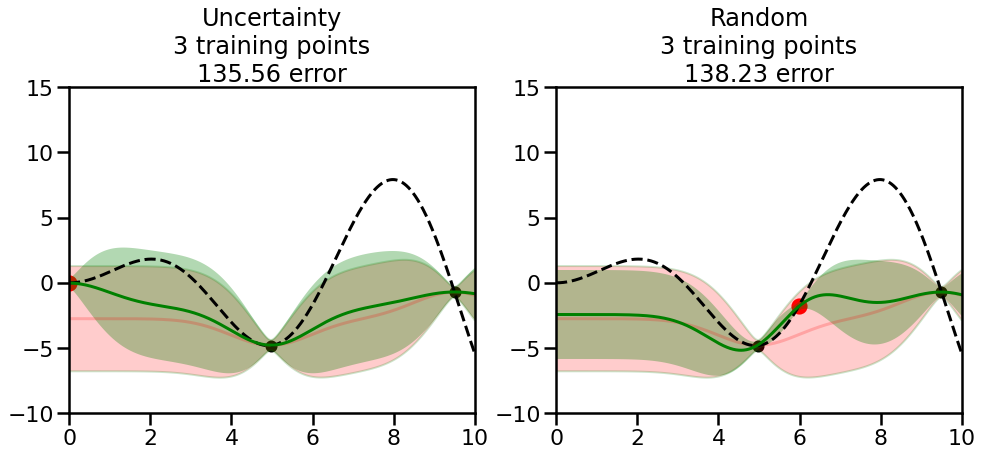

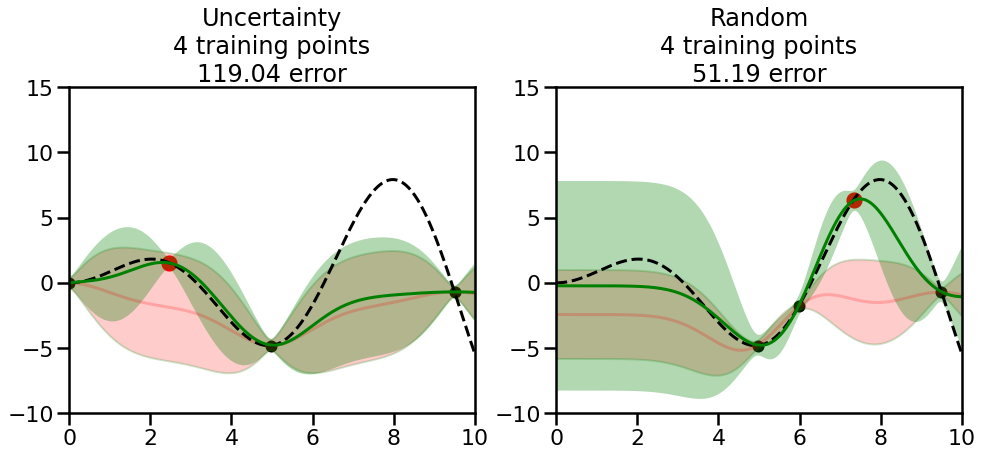

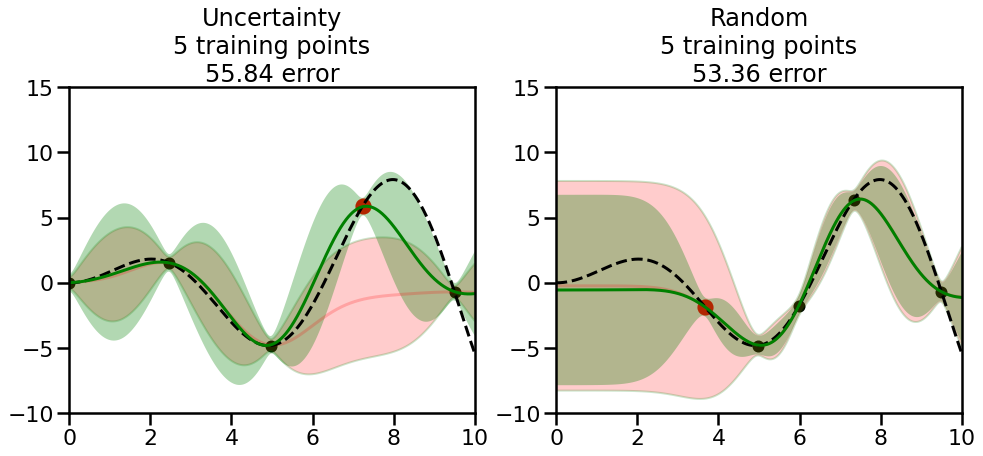

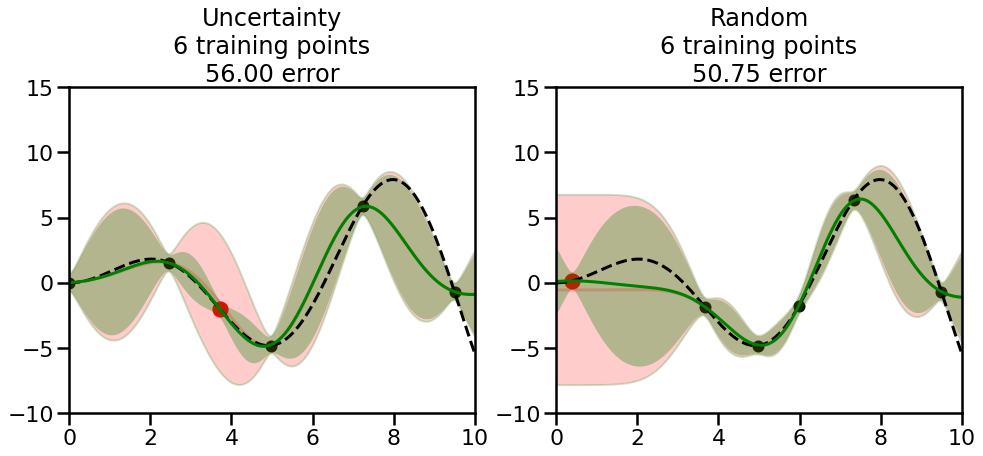

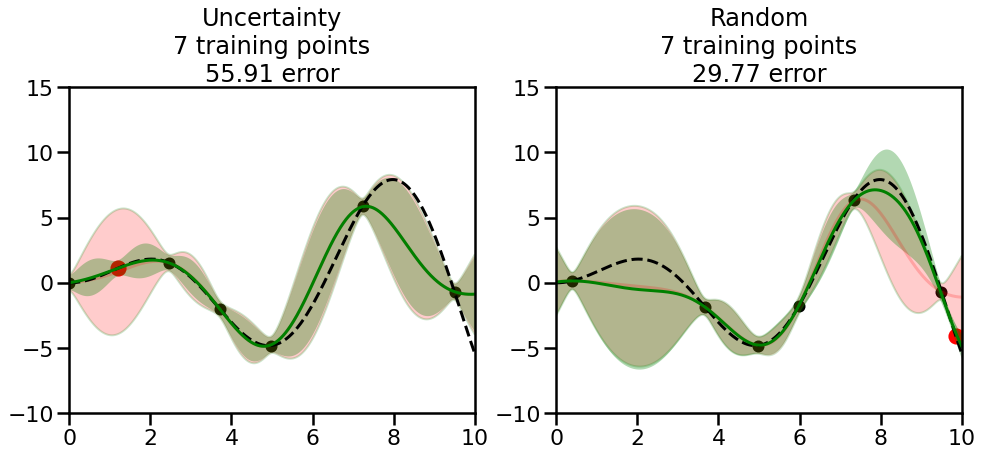

...

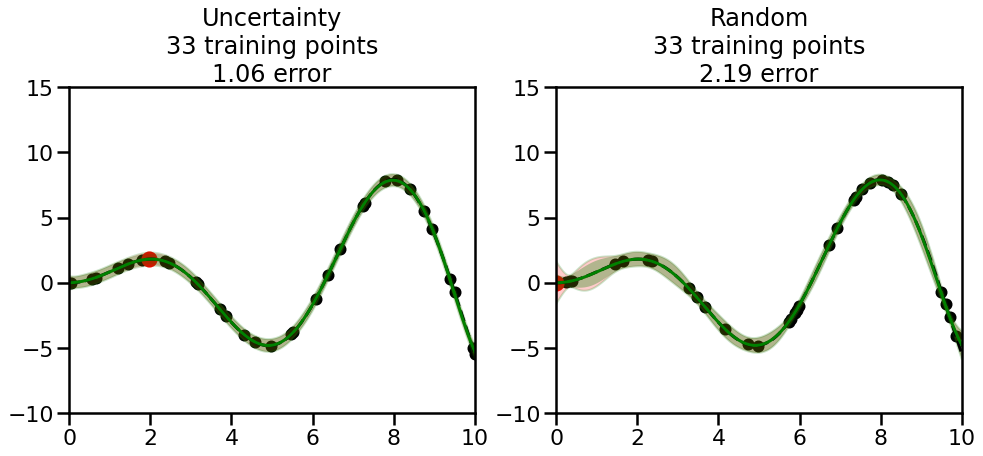

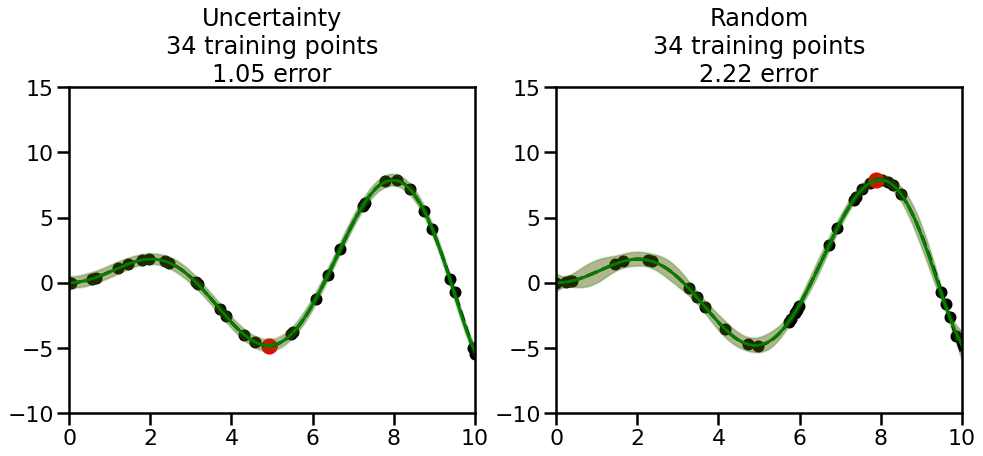

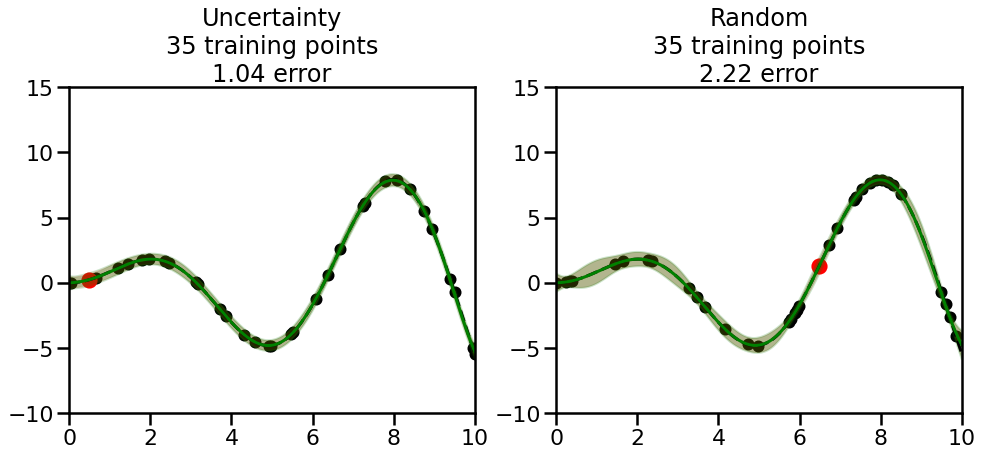

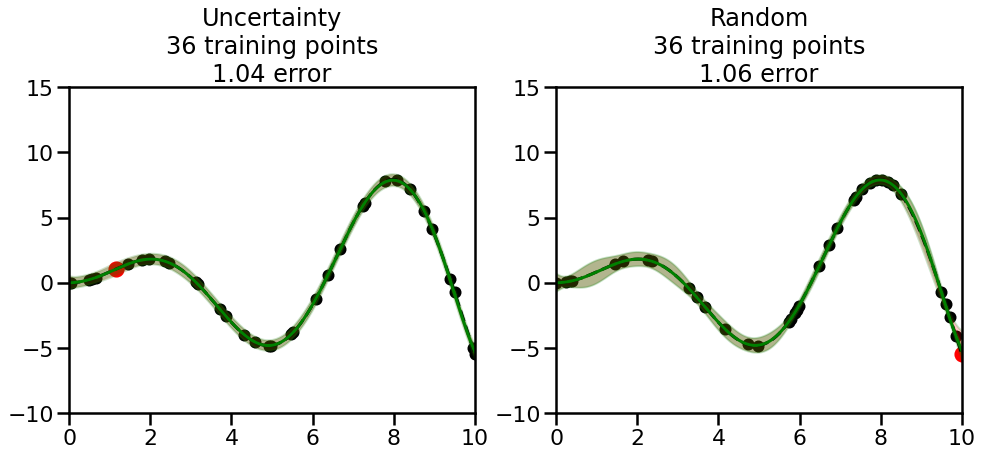

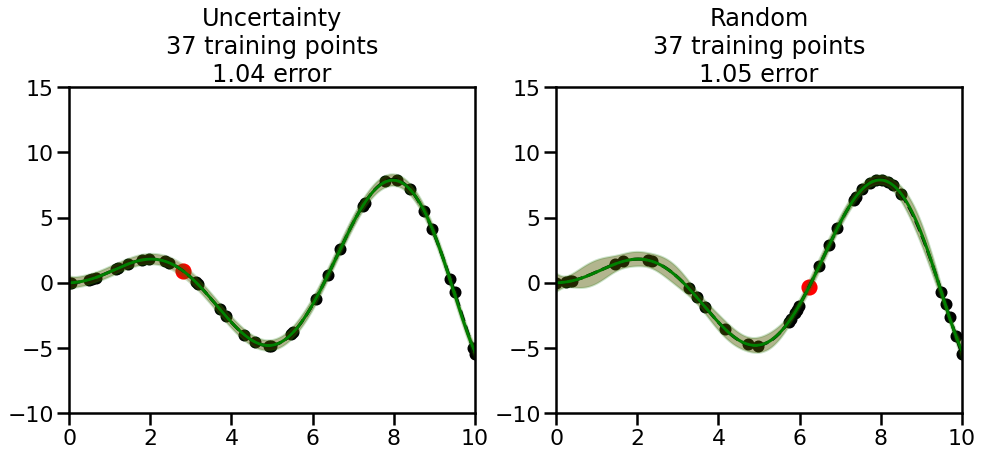

In [5]:
# Create the Gaussian Process model
kernel = RBF(length_scale=1) #+  WhiteKernel(noise_level=0.01)
gp = GaussianProcessRegressor(kernel=kernel, alpha=0.01,
                              optimizer=None, normalize_y=True, random_state=1)

# Now, ready to begin learning!
# We will have two different models that we'll test out:
# 1) Uncertainty Sampling: Pick points where we are most uncertain
# 2) Random Sampling: Pick points randomly
# train_ind holds the indices of what training samples we'll use
train_ind ={
    'Uncertainty':   np.zeros(len(X),dtype=bool),
    'Random':np.zeros(len(X),dtype=bool)
}
options = train_ind.keys()

possible_points = np.array(list(range(len(X))))
# Possible Initialization options
# 1. Start with the same two randomly selected points
for ind in np.random.choice(possible_points,2):
    for o in options:
        train_ind[o][ind] = True
# Or
# 2. Start with end-points
#for o in options:
#    train_ind[o][0] = True
#    train_ind[o][-1] = True

# How much data should we collect?
num_total_samples = 35

# Let's store the errors for the models:
errors = {'Uncertainty':np.zeros(num_total_samples),
          'Random':np.zeros(num_total_samples)}

# Let's select an increasing number of new points to try:
for i in range(num_total_samples):
    # As i increases, we increase the number of points
    plt.figure(figsize=(16,6))
    for j,o in enumerate(options): # For each sampling option 
        plt.subplot(1,2,j+1)  # Create different subplot
        
        # Fit the original GP Model (without the new point):
        gp.fit(X[train_ind[o],:],y[train_ind[o]])
        
        # Plot the original model's bounds (just for comparison sake)
        yp,sigma = gp.predict(x, return_std=True)
        plt.fill(np.concatenate([x, x[::-1]]),
                np.concatenate([yp - 1.9600 * sigma,
                               (yp + 1.9600 * sigma)[::-1]]),'r',
                alpha=0.2,  ec='g', label='95% confidence interval')
        # Plot the predicted function
        plt.plot(x,yp,'r-',alpha=0.2)
        
        #######
        # Now do the Active Learning part
        #######     
        if o == 'Uncertainty':
            # First, we need to predict the MSE (uncertainty) at
            # each of the non-training points:
            yp,sigma = gp.predict(X[~train_ind[o],:], return_std=True)
            
            # The points that we'll choose from are the points that have the
            # maximum mean square error in the GP (highest uncertainty)
            candidates = np.extract(sigma == np.amax(sigma),X[~train_ind[o],:])
            
            # Side note:
            # If you wanted to turn Uncertainty Sampling into Global Bayesian
            # Optimization instead, then uncomment the below two lines
#             ucb = yp + 1.96*sigma
#             candidates = np.extract(ucb == np.amax(ucb),X[~train_ind[o],:])
            
            # Choose the next sampling point randomly from the max candidates
            # (It is unlikely that len(candidates)>1, but you never know)
            next_point = np.random.choice(candidates.flatten())
            # Find the training sample index corresponding to the next sample
            next_ind = np.argwhere(X.flatten() == next_point)
            
        elif o == 'Random':
            # Just pick the point randomly from the points that we 
            # haven't chosen already (i.e., ~train_ind[o])
            next_ind = np.random.choice(possible_points[~train_ind[o]],1)
            
        # Add the selected point to the training samples
        train_ind[o][next_ind] = True
        
        #######
        # Done with Active Learning part
        #######   
        
        # Fit the GP again, this time with the added training point:
        gp.fit(X[train_ind[o],:],y[train_ind[o]])
        
        # Now plot the updated model so we can see the difference:
        yp,sigma = gp.predict(x, return_std=True)
        
        # Draw the 95% Confidence Interval
        plt.fill(np.concatenate([x, x[::-1]]),
                np.concatenate([yp - 1.9600 * sigma,
                               (yp + 1.9600 * sigma)[::-1]]),'g',
                alpha=0.3,  ec='None', label='95% confidence interval')
        # Plot the original function
        plt.plot(x,f(x),'k--',alpha=1)
        # Plot the predicted function
        plt.plot(x,yp,'g-',alpha=1)
        # Plot the original training points
        plt.scatter(X[train_ind[o],:],y[train_ind[o]],color='k',s=100)
        # Highlight the point we just added
        plt.scatter(X[next_ind,:].flatten(),y[next_ind].flatten(),color='r',s=200)
        plt.ylim([-10,15]) # Set the y-axis limits
        plt.xlim([0,10])   # Set the x-axis limits
        # Label the figure title with the number of total training points
        # and the total error between the predicted and actual curves
        n_train = np.count_nonzero(train_ind[o])
        error = np.linalg.norm(yp-f(x).flatten())
        errors[o][i]=error
        plt.title("%s\n%d training points\n%.2f error"%(o,n_train,error))
    plt.show()

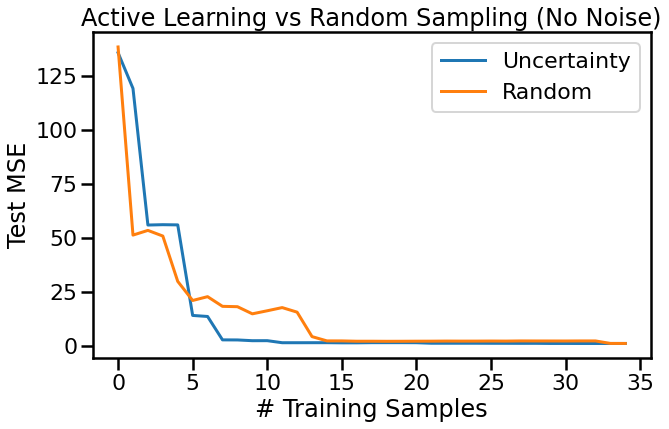

In [6]:
plt.figure(figsize=(10,6))
for o in options: # For each sampling option
    plt.plot(errors[o],label=o)
plt.legend()
plt.xlabel("# Training Samples")
plt.ylabel("Test MSE")
plt.title("Active Learning vs Random Sampling (No Noise)")
plt.show()

# Active Learning with Noise
Compare the number of training samples and the Mean Squared Error across the Uncertainty Sampling and Random conditions:

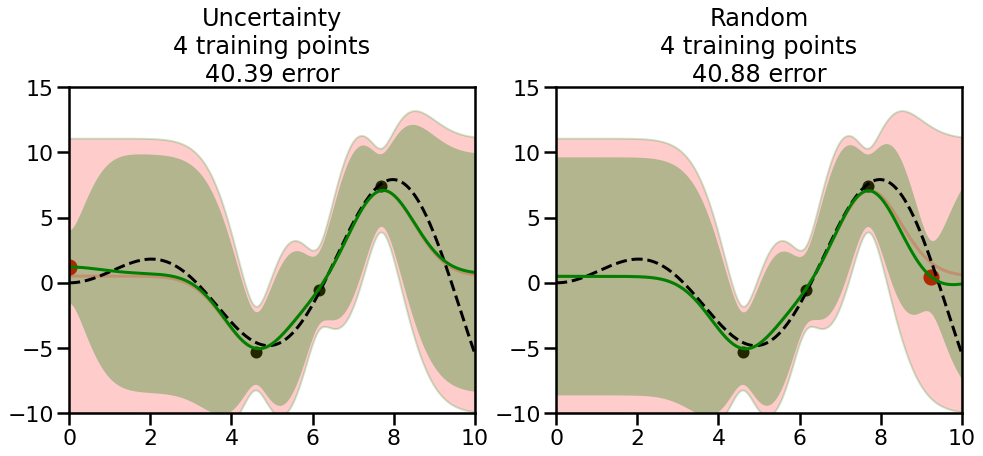

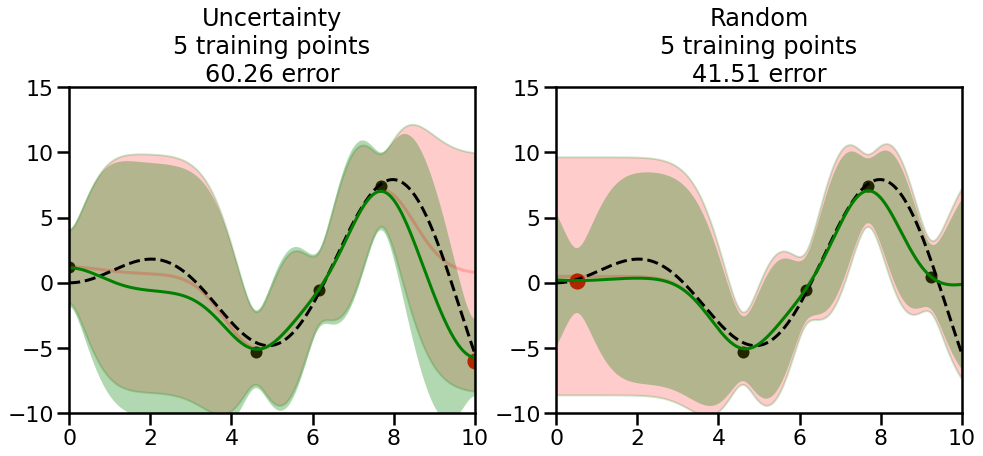

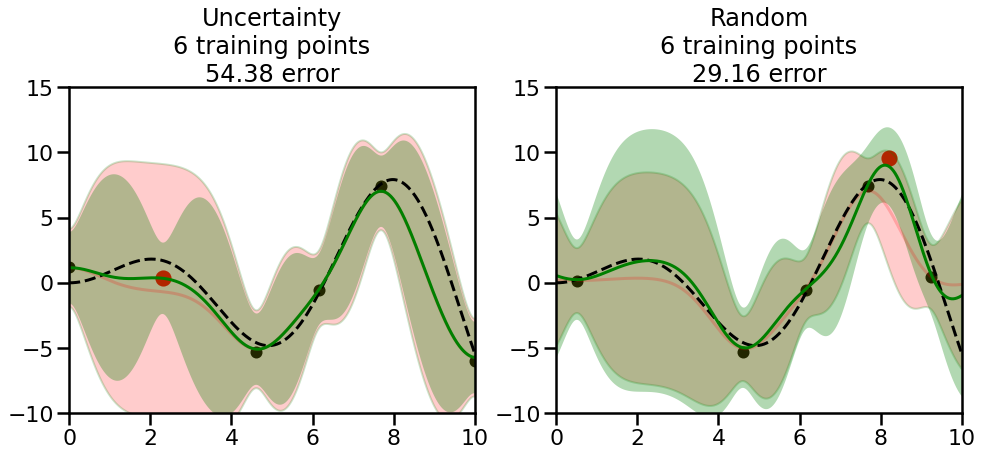

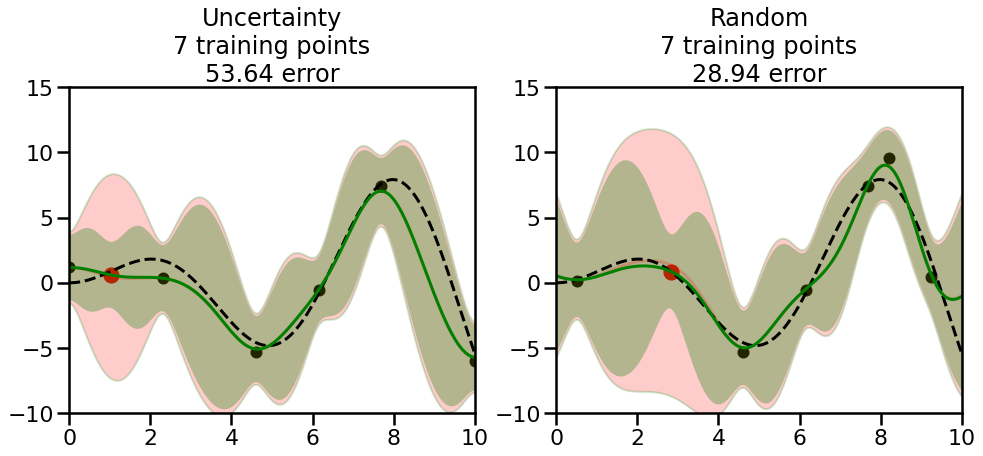

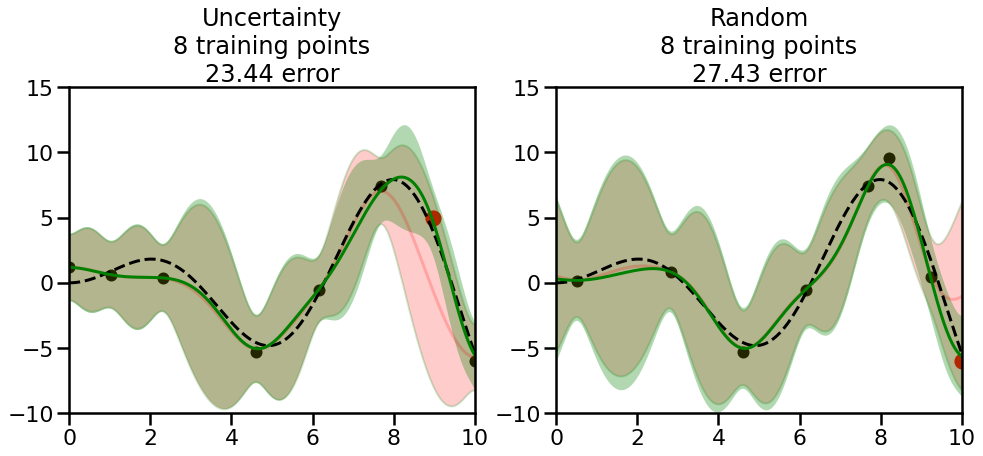

...

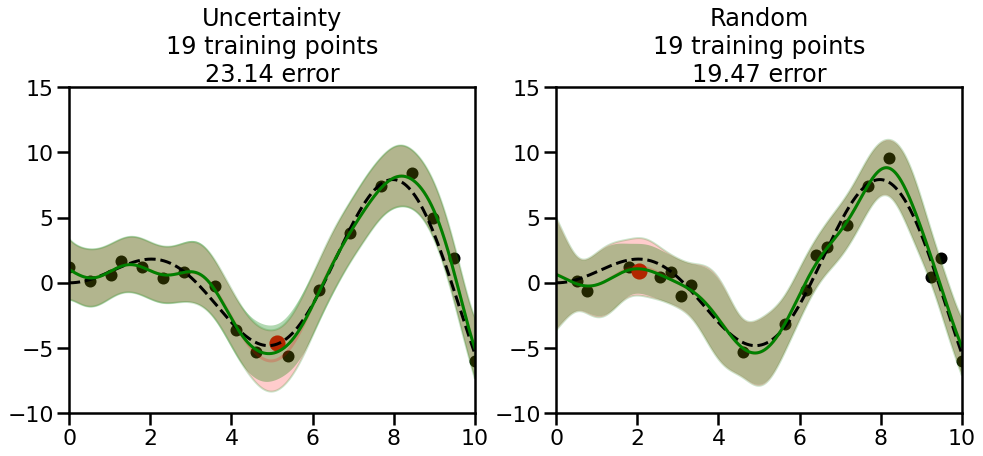

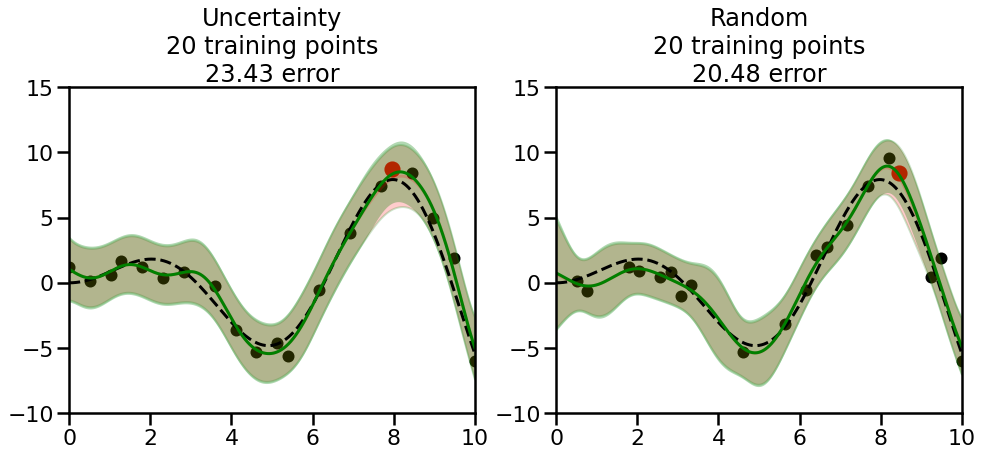

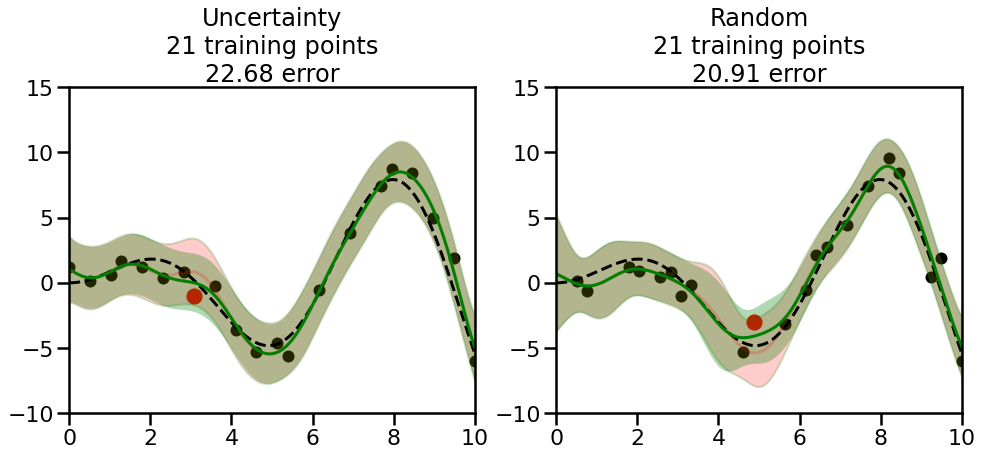

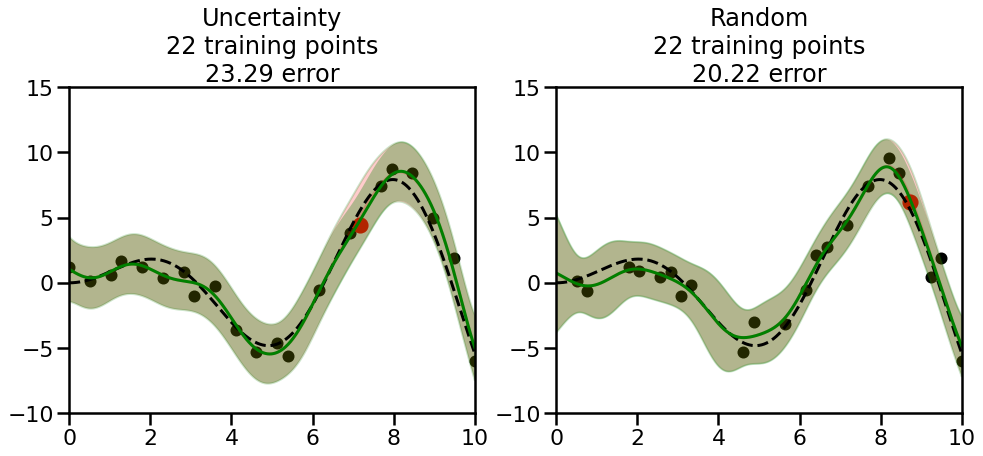

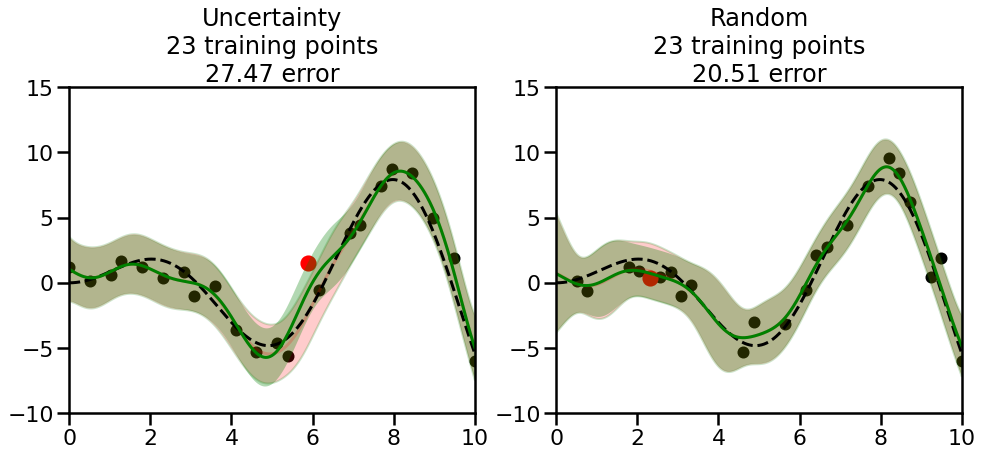

In [7]:
# ------- Try changing the below -------
noise_factor = 1.5        # e.g. between 0 and 5
RBF_length_scale = 0.8    # e.g., between 0.1 and 5
# --------------------------------------

np.random.seed(1)
def f(x):
    """The function to predict."""
    return x * np.sin(x)
    #return 5 * np.sinc(x)
    #return x

#----------------------------------------------------------------------
#  First the noiseless case
X = np.atleast_2d(np.linspace(0, 10, 40)).T

# Observations
y = f(X).ravel() # Noiseless observations
# Add some noise
dy = 0.5 + 1.0 * np.random.random(y.shape)
noise = np.random.normal(0, noise_factor*dy)
y += noise

# Create the Gaussian Process model
kernel = RBF(length_scale=RBF_length_scale, length_scale_bounds=(0.5, 1.5)) + \
         WhiteKernel(noise_level=0.05,noise_level_bounds=(0.01, 0.2))
gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer =10,
                              optimizer=None, # 'fmin_l_bfgs_b' or None
                              normalize_y=True, random_state=1)


# Same code as above. See above for detailed comments
train_ind ={
    'Uncertainty':   np.zeros(len(X),dtype=bool),
    'Random':np.zeros(len(X),dtype=bool)
}
options = train_ind.keys()

possible_points = np.array(list(range(len(X))))
for ind in np.random.choice(possible_points,3):
    for o in options:
        train_ind[o][ind] = True
        
        
# How much data should we collect?
num_total_samples = 20

# Let's store the errors for the models:
errors = {'Uncertainty':np.zeros(num_total_samples),
          'Random':np.zeros(num_total_samples)}
    
# Let's select an increasing number of new points to try:
for i in range(num_total_samples):
    # As i increases, we increase the number of points
    plt.figure(figsize=(16,6))
    for j,o in enumerate(options): # For each sampling option 
        plt.subplot(1,2,j+1)  # Create different subplot
        
        # Fit the original GP Model (without the new point):
        gp.fit(X[train_ind[o],:],y[train_ind[o]])
        
        # Plot the original model's bounds (just for comparison sake)
        yp,sigma = gp.predict(x, return_std=True)
        plt.fill(np.concatenate([x, x[::-1]]),
                np.concatenate([yp - 1.9600 * sigma,
                               (yp + 1.9600 * sigma)[::-1]]),'r',
                alpha=0.2,  ec='g', label='95% confidence interval')
        # Plot the predicted function
        plt.plot(x,yp,'r-',alpha=0.2)
   
        if o == 'Uncertainty':
            yp,sigma = gp.predict(X[~train_ind[o],:], return_std=True)
            candidates = np.extract(sigma == np.amax(sigma),X[~train_ind[o],:])
            next_point = np.random.choice(candidates.flatten())
            next_ind = np.argwhere(X.flatten() == next_point)
        elif o == 'Random':
            next_ind = np.random.choice(possible_points[~train_ind[o]],1)
            
        # Add the selected point to the training samples
        train_ind[o][next_ind] = True

        # Fit the GP again, this time with the added training point:
        gp.fit(X[train_ind[o],:],y[train_ind[o]])
        yp,sigma = gp.predict(x, return_std=True)
        
        plt.fill(np.concatenate([x, x[::-1]]),
                np.concatenate([yp - 1.9600 * sigma,
                               (yp + 1.9600 * sigma)[::-1]]),'g',
                alpha=0.3,  ec='None', label='95% confidence interval')
        plt.plot(x,f(x),'k--',alpha=1)
        plt.plot(x,yp,'g-',alpha=1)
        plt.scatter(X[train_ind[o],:],y[train_ind[o]],color='k',s=100)
        plt.scatter(X[next_ind,:].flatten(),y[next_ind].flatten(),color='r',s=200)
        plt.ylim([-10,15]) # Set the y-axis limits
        plt.xlim([0,10])   # Set the x-axis limits
        n_train = np.count_nonzero(train_ind[o])
        error = np.linalg.norm(yp-f(x).flatten())
        errors[o][i]=error
        plt.title("%s\n%d training points\n%.2f error"%(o,n_train,error))
    plt.show()

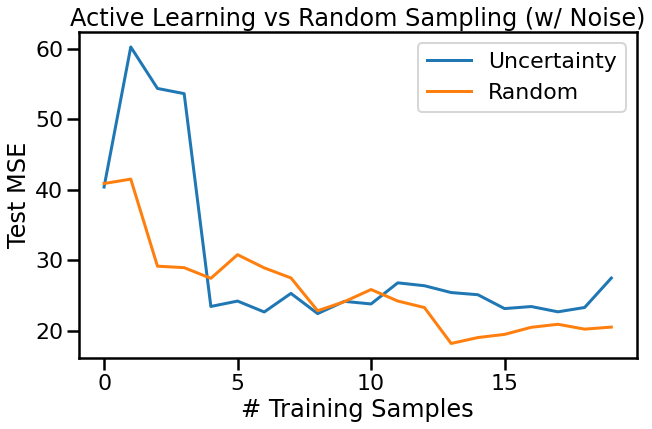

In [8]:
plt.figure(figsize=(10,6))
for o in options: # For each sampling option
    plt.plot(errors[o],label=o)
plt.legend()
plt.xlabel("# Training Samples")
plt.ylabel("Test MSE")
plt.title("Active Learning vs Random Sampling (w/ Noise)")
plt.show()

## Questions to think about and discuss
1. What happens to Uncertainty Sampling compared to Random Sampling as we increase the noise in the data?
2. What happens to Uncertainty Sampling compared to Random as we decrease the RBF length scale (i.e., allow more high frequency function behavior)?

# Boundary Classification
Compare the number of training samples and the Classification Accuracy across the Uncertainty Sampling and Random conditions. You can also try changing the noise parameter for the Moon's dataset and looking at how that affects things.

Pay special attention to which points the algorithms pick out for training, and how the resulting training data look different after 50-ish iterations.

In [36]:
from sklearn.datasets import make_swiss_roll
# Make a double roll dataset
def roll_it(n_samples=1000, noise=0.0):
    X1 = make_swiss_roll(n_samples=int(n_samples/2),noise=noise)[0][:,[0,2]]
    X2 = make_swiss_roll(n_samples=int(n_samples/2),noise=noise)[0][:,[0,2]]
    X = np.vstack([X1,-X2])
    y = np.hstack([[0]*len(X1),[1]*len(X2)])
    return X,y

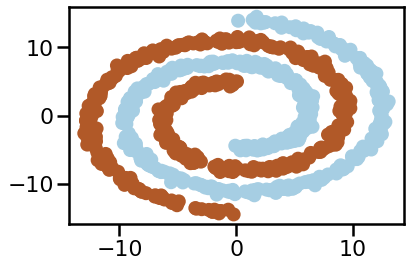

In [37]:
# 2-D Non-Linear Classification
# Moons dataset
from sklearn.datasets import make_moons,make_circles
np.random.seed(3) # So we all see the same thing
n_samples = 1000  # Number of data samples


# ------------------- Try Uncommenting the Below --------------
# Dataset 1
# Low Noise
#X, y = make_moons(n_samples=n_samples, noise=0.1)

# Higher Noise
# X, y = make_moons(n_samples=n_samples, noise=0.25)

# Dataset 2
X,y = make_circles(n_samples = n_samples, factor=0.7, noise = .05)

# Dataset 3
X,y = roll_it(n_samples,0.05*5)

# Dataset 4
# X, y = make_moons(n_samples=n_samples, noise=0.1)
# Xt=np.random.multivariate_normal([-0.7,1.5],np.diag([0.01,0.01]),size=20)
# X = np.r_[X,Xt]
# y = np.r_[y,np.ones(len(Xt))]

# ---------------------------------------------------------------

plt.figure()
plt.scatter(X[:, 0], X[:, 1], c=y, cmap=plt.cm.Paired)
plt.axis('tight')
plt.show()

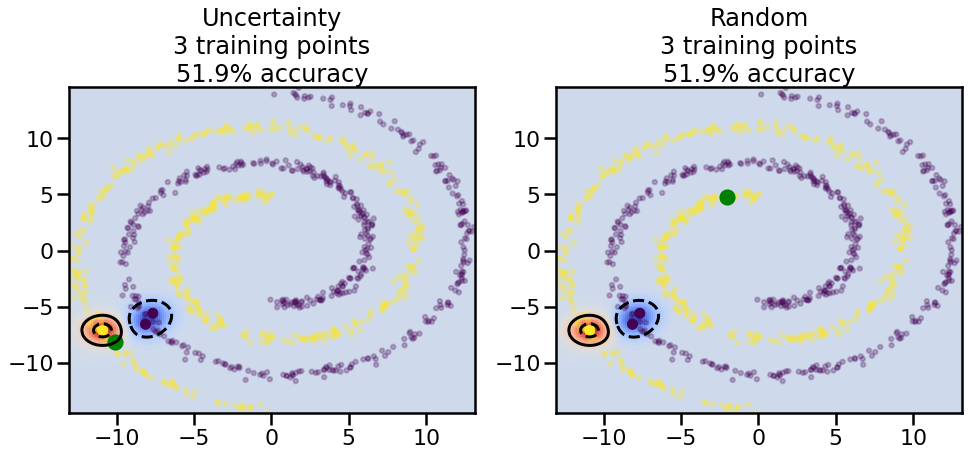

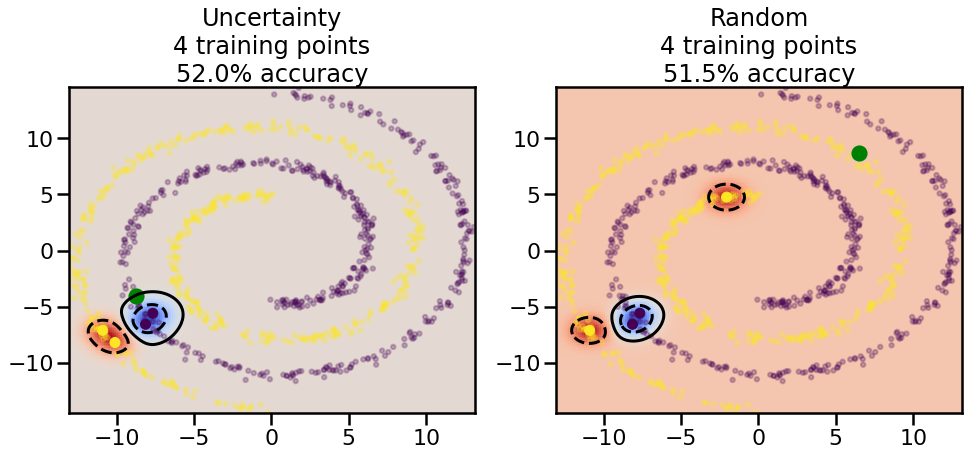

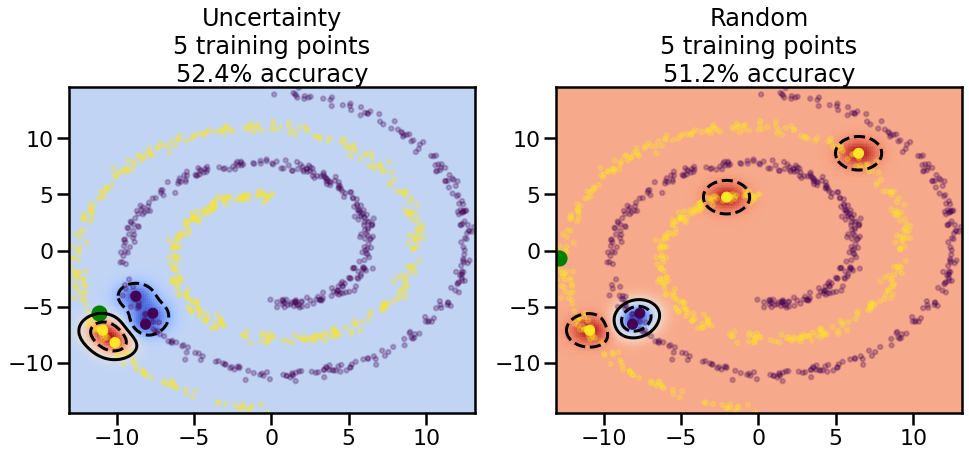

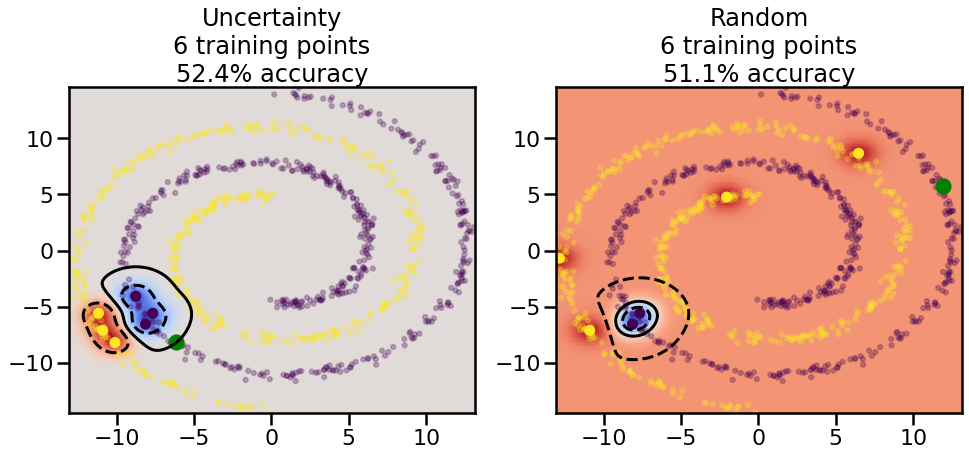

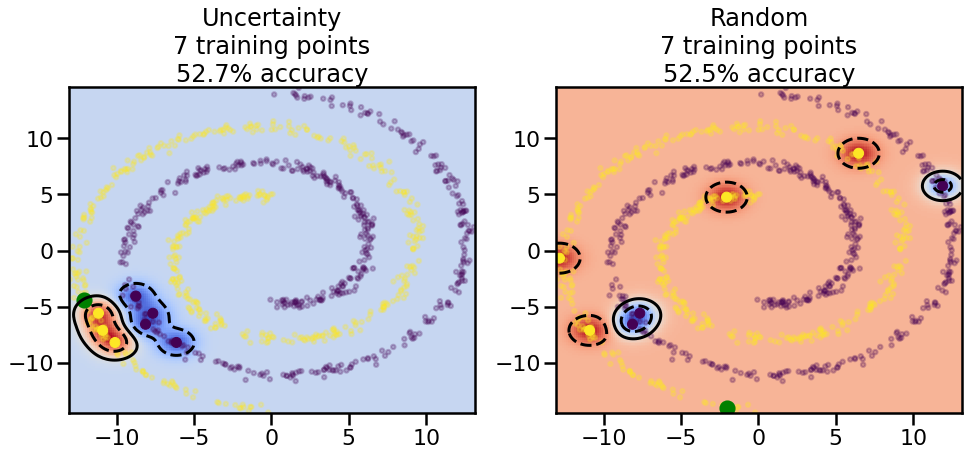

...

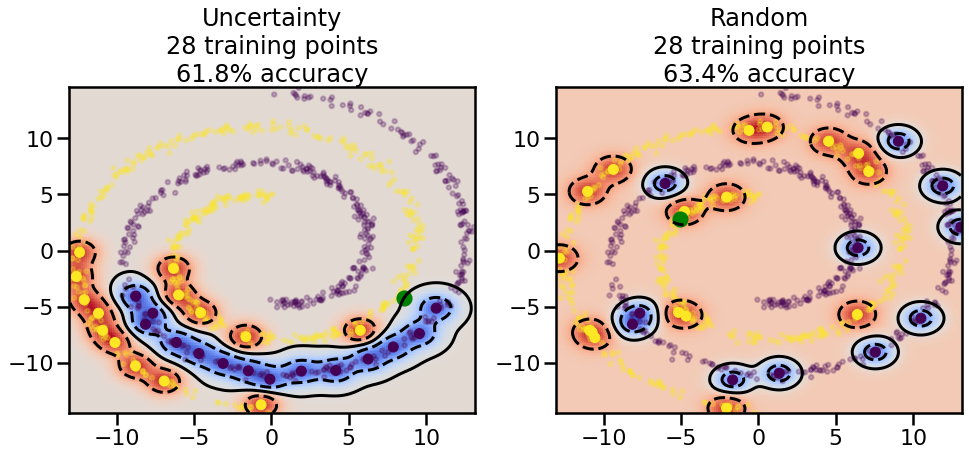

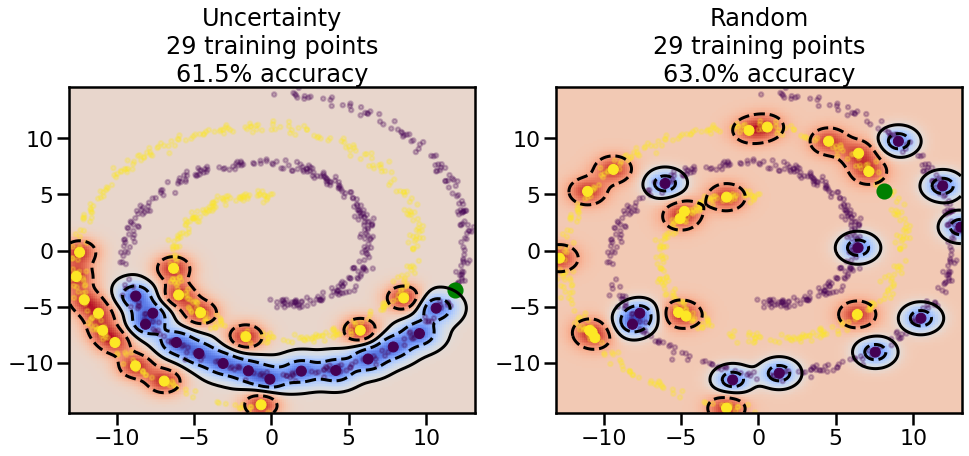

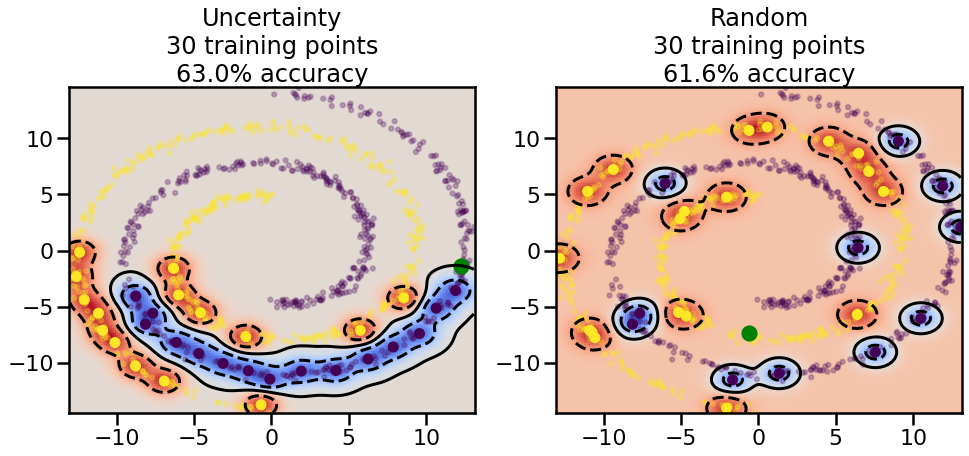

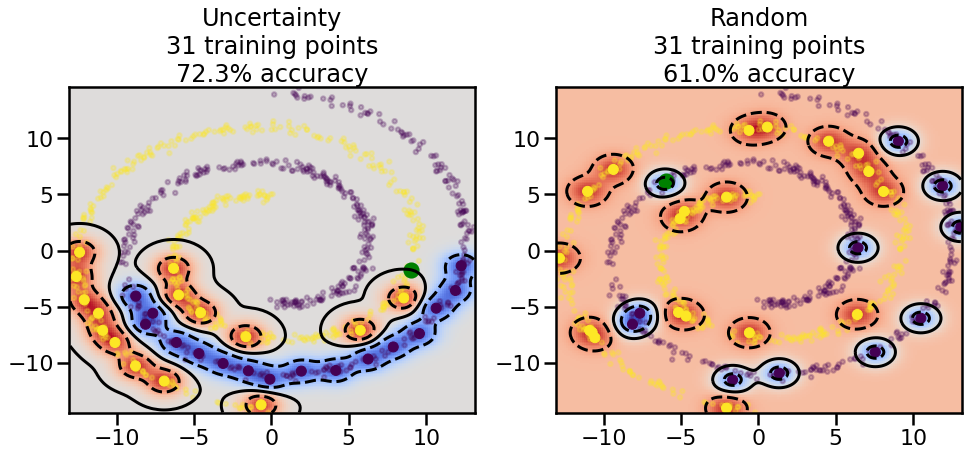

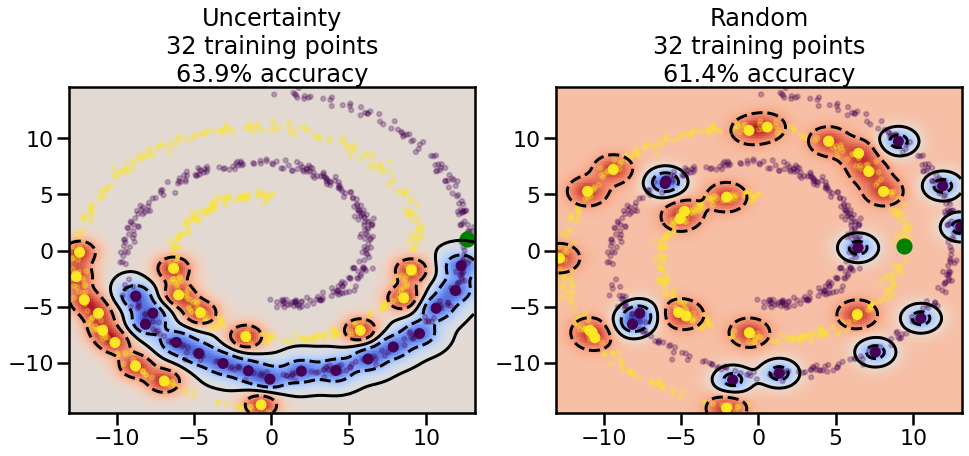

In [38]:
# ------- Try changing the below -------
gamma = 0.7   # e.g. between 0.1 and 5
# --------------------------------------

from sklearn import svm
np.random.seed(3)
# Now, ready to begin learning:
train_ind ={
    'Uncertainty':   np.zeros(len(X),dtype=bool),
    'Random':np.zeros(len(X),dtype=bool)
}
options = train_ind.keys()

possible_points = np.array(list(range(len(X))))
# Initialization options
# 1. Select different points randomly
for i in range(3):
    ind = np.random.choice(possible_points[y==i%2])
    for o in options:
        train_ind[o][ind] = True

# Trying different classifiers
clf = svm.SVC(kernel='rbf',gamma=gamma)

# How much data should we collect?
num_total_samples = 30

# Let's store the errors for the models:
errors = {'Uncertainty':np.zeros(num_total_samples),
          'Random':np.zeros(num_total_samples)}

for i in range(num_total_samples):
    # As i increases, we increase the number of points
    plt.figure(figsize=(16,6))
    for j,o in enumerate(options):
        plt.subplot(1,2,j+1)        
        
        # Get data on original model (before we select next point)    
        n_train = np.count_nonzero(train_ind[o])
        clf.fit(X[train_ind[o],:],y[train_ind[o]])
        accuracy = clf.score(X[~train_ind[o],:],y[~train_ind[o]])
        
        # Plot the decision function
        x_min = X[:, 0].min()
        x_max = X[:, 0].max()
        y_min = X[:, 1].min()
        y_max = X[:, 1].max()
        XX, YY = np.mgrid[x_min:x_max:200j, y_min:y_max:200j]
        Z = clf.decision_function(np.c_[XX.ravel(), YY.ravel()])

        # Put the result into a color plot
        Z = Z.reshape(XX.shape)
        plt.pcolormesh(XX, YY, Z, cmap=plt.get_cmap('coolwarm'),shading='auto')
        plt.contour(XX, YY, Z, colors=['k', 'k', 'k'],
                    linestyles=['--', '-', '--'],
                    levels=[-.5, 0, .5])

        # Plot the training points
        plt.scatter(X[:,0],X[:,1],c=y,s=20,alpha=0.25)
        plt.scatter(X[train_ind[o],0],X[train_ind[o],1],
                    c=y[train_ind[o]],s=100,lw=1)
        
        #clf.fit(X[train_ind[o],:],y[train_ind[o]])
        #yp,MSE = clf.predict(X[~train_ind[o],:])
        # Calculate distance to decision boundary
        # (We're less certain at the boundary)
        dists = clf.decision_function(X[~train_ind[o],:])
        dists = np.abs(dists) # Want absolute distance from boundary
        if o == 'Uncertainty':
            # Basic Uncertainty sampling
            # Compute closest points and then pick randomly among
            # the closet points
            closest_points = np.argwhere(dists == np.amin(dists)).ravel()
            ind = np.random.choice(closest_points)
            next_point = X[~train_ind[o],:][ind,:].flatten()
            next_ind = np.argwhere(X == next_point.flatten())[0,0]
        elif o == 'Random':
            next_ind = np.random.choice(possible_points[~train_ind[o]],1)
        elif o == 'Density':
            # Multiply distances by similarity score
            # TBD
            pass
        else:
            raise Error
        train_ind[o][next_ind] = True
        
        # Plot the selected point in green
        plt.scatter(X[next_ind,0],X[next_ind,1],c='g',s=200)
        
        errors[o][i]=accuracy
        plt.title("%s\n%d training points\n%.1f%% accuracy"%(o,n_train,accuracy*100))
    plt.show()

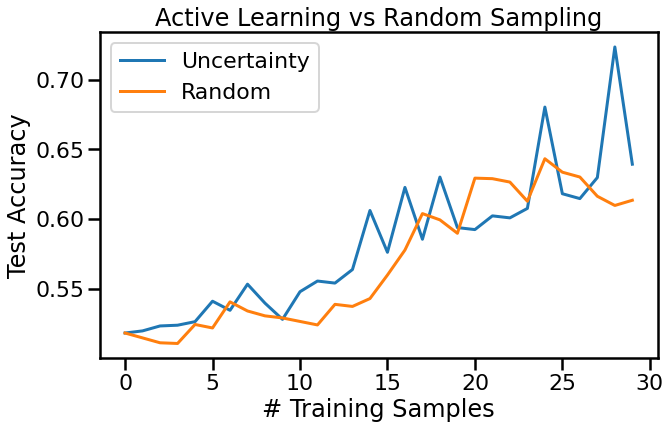

In [39]:
plt.figure(figsize=(10,6))
for o in options: # For each sampling option
    plt.plot(errors[o],label=o)
plt.legend()
plt.xlabel("# Training Samples")
plt.ylabel("Test Accuracy")
plt.title("Active Learning vs Random Sampling")
plt.show()

## Questions to think about and discuss

1. How are the selected data points distributed using uncertainty sampling? How do they differ from those selected by Random Sampling?
2. What happens when you increase the noise level on Dataset one (Moons)? How does the relative performance of Uncertainty sampling change as the noise increases?
3. How does the difference between Uncertainty Sampling and Random Sampling change when we move to more complicated datasets (e.g., Dataset 3 - the swiss roll example?)
4. How does the comparative behavior of Active Learning change when you change the underlying model (say, in this case, by changing gamma -- the RBF kernel bandwidth)?

# Semi-Supervised Learning

In addition to Active Learning, we can use [Semi-Supervised Learning](http://scikit-learn.org/stable/modules/label_propagation.html#semi-supervised) to improve the availability of unlabeled data. Semi-Supervised learning works by assigning unlabeled points a label based on nearby supervised data points. This "spreads" information to unlabeled points and can help leverage the structure of data manifolds to improve prediction.

Text(0.5, 1.0, 'Labels Spread using Semi-Supervised Learning')

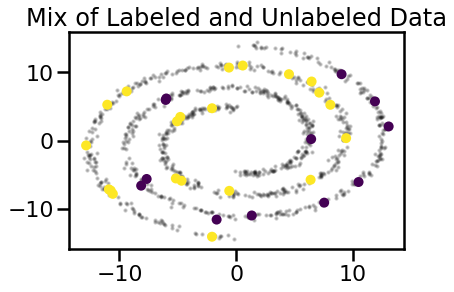

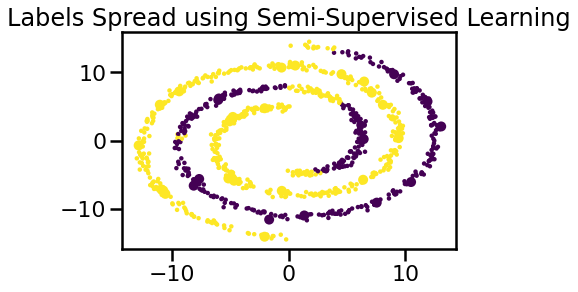

In [40]:
from sklearn.semi_supervised import LabelSpreading
# Select a small number of starter points:
train = train_ind['Random']

plt.figure()
# Plot in small dots the unlabeled data
plt.scatter(X[~train,0],X[~train,1],c='k',s=5,alpha=0.2)
plt.scatter(X[train,0],X[train,1],c=y[train],s=100,lw=0)
plt.title("Mix of Labeled and Unlabeled Data")

# Do the semi-supervised learning
label_prop_model = LabelSpreading()
labels = -np.ones_like(y)
labels[train] = y[train]
label_prop_model.fit(X, labels)
l = label_prop_model.transduction_

# Plot the results
plt.figure()
plt.scatter(X[:,0],X[:,1],c=l,lw=0, s=20)
plt.scatter(X[train,0],X[train,1],c=y[train],s=100,lw=0)
plt.title("Labels Spread using Semi-Supervised Learning")

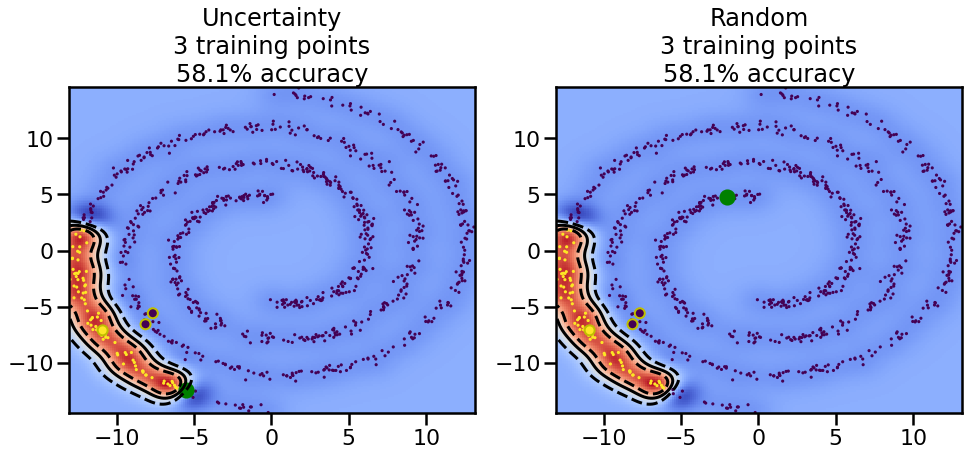

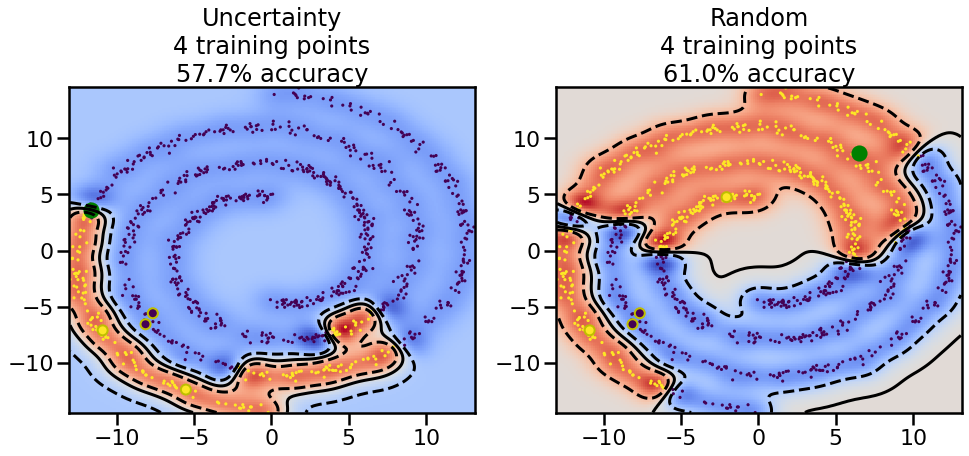

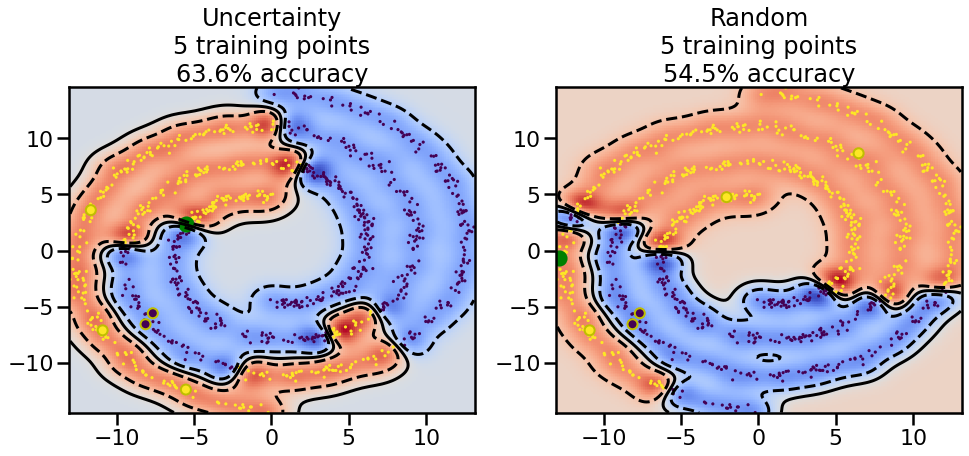

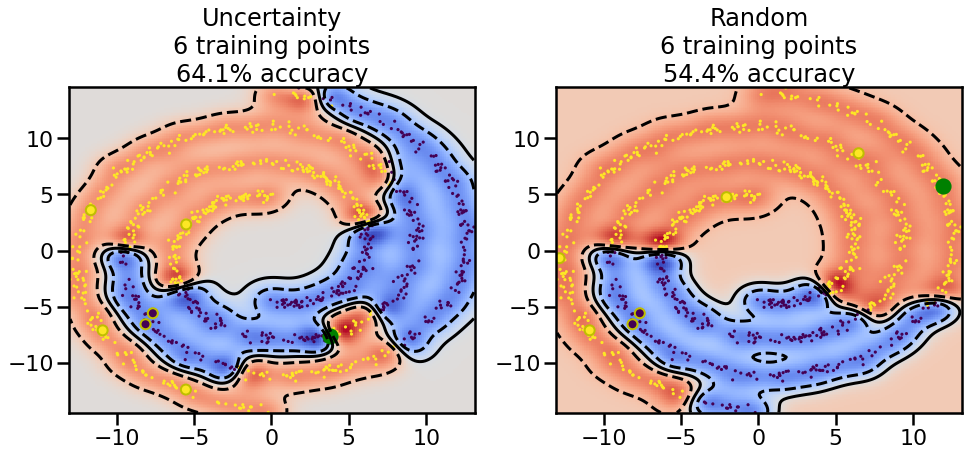

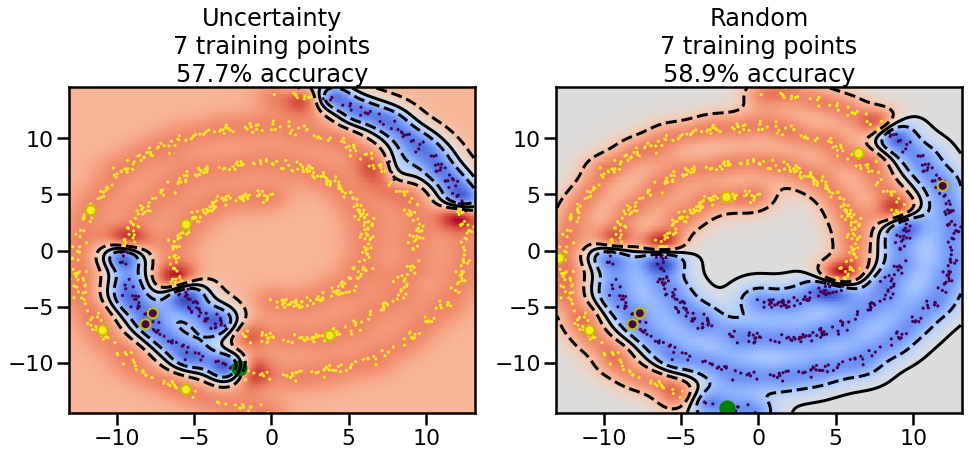

...

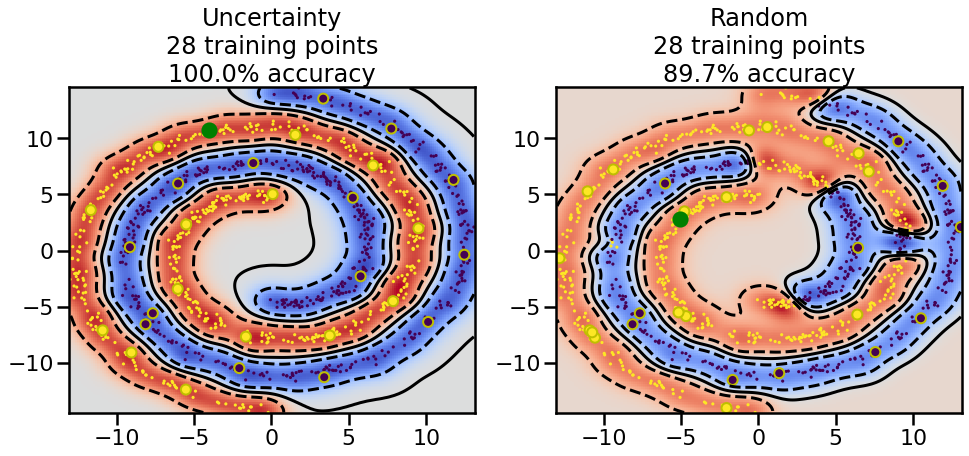

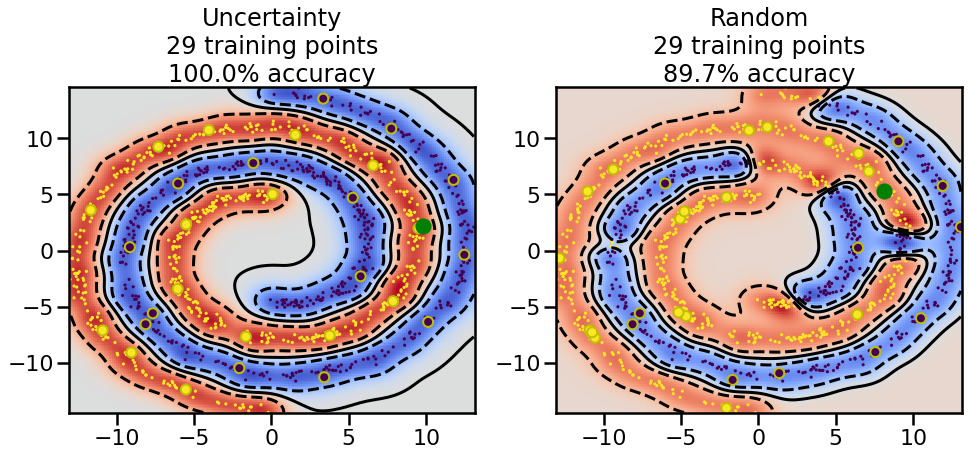

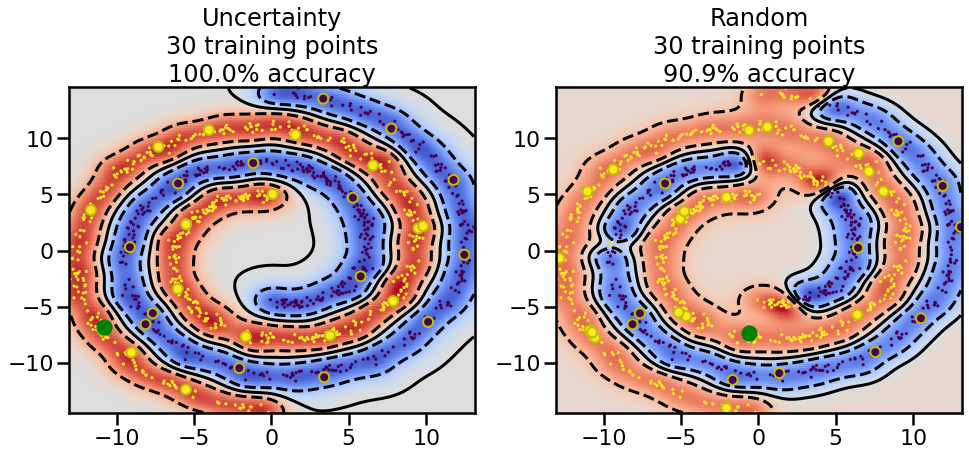

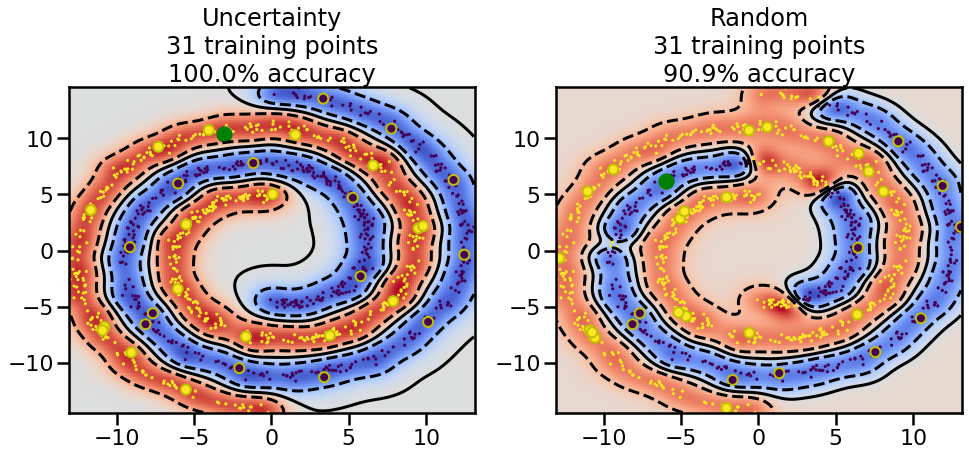

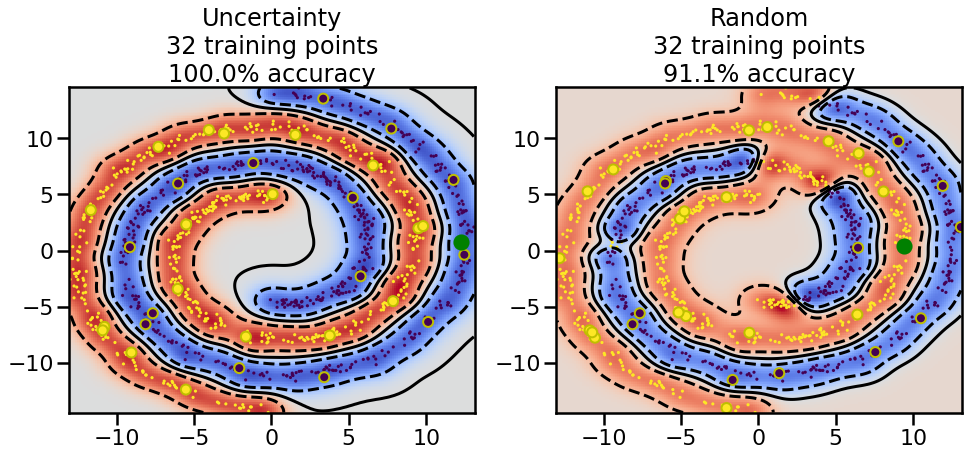

In [41]:
# ------- Try changing the below -------
gamma = 0.5   # e.g. between 0.1 and 5
# --------------------------------------


# Reset the random seed
np.random.seed(3) # So we all see the same thing

# Now, ready to begin learning:
train_ind ={
    'Uncertainty':   np.zeros(len(X),dtype=bool),
    'Random':np.zeros(len(X),dtype=bool)
}
options = train_ind.keys()

possible_points = np.array(list(range(len(X))))
# Initialization
for i in range(3):
    ind = np.random.choice(possible_points[y==i%2])
    for o in options:
        train_ind[o][ind] = True

# Classifiers
clf = svm.SVC(kernel='rbf',gamma=gamma)
label_prop_model = LabelSpreading()

# How much data should we collect?
num_total_samples = 30

# Let's store the errors for the models:
semi_errors = {'Uncertainty':np.zeros(num_total_samples),
               'Random':np.zeros(num_total_samples)}

for i in range(num_total_samples):
    # As i increases, we increase the number of points
    plt.figure(figsize=(16,6))
    for j,o in enumerate(options):
        plt.subplot(1,2,j+1)        
        
        # Plot intermediate results    
        n_train = np.count_nonzero(train_ind[o])
        
        # Do Label Spreading:
        labels = -np.ones_like(y)
        labels[train_ind[o]] = y[train_ind[o]]
        label_prop_model.fit(X, labels)
        l = label_prop_model.transduction_
        
        clf.fit(X,l)
        accuracy = clf.score(X[~train_ind[o],:],y[~train_ind[o]])
        
        # Plot the decision function
        x_min = X[:, 0].min()
        x_max = X[:, 0].max()
        y_min = X[:, 1].min()
        y_max = X[:, 1].max()

        XX, YY = np.mgrid[x_min:x_max:200j, y_min:y_max:200j]
        Z = clf.decision_function(np.c_[XX.ravel(), YY.ravel()])

        # Put the result into a contour plot
        Z = Z.reshape(XX.shape)
        plt.pcolormesh(XX, YY, Z , cmap=plt.get_cmap('coolwarm'),shading='auto')
        plt.contour(XX, YY, Z, colors=['k', 'k', 'k'], linestyles=['--', '-', '--'],
                    levels=[-.5, 0, .5])

        # Plot the training points
        plt.scatter(X[:,0],X[:,1],c=l,lw = 0,s=10,alpha=1)
        plt.scatter(X[train_ind[o],0],X[train_ind[o],1],c=y[train_ind[o]],s=100,lw=2,edgecolor='y')
        
        dists = clf.decision_function(X[~train_ind[o],:])
        dists = np.abs(dists)
        if o == 'Uncertainty':
            closest_points = np.argwhere(dists == np.amin(dists)).ravel()
            # Basic Uncertainty sampling---just choose randomly
            ind = np.random.choice(closest_points)
            next_point = X[~train_ind[o],:][ind,:].flatten()
            next_ind = np.argwhere(X == next_point.flatten())[0,0]
        elif o == 'Random':
            next_ind = np.random.choice(possible_points[~train_ind[o]],1)
        elif o == 'Density':
            # Multiply distances by similarity score
            # TBD
            pass
        else:
            raise Error
        train_ind[o][next_ind] = True
        
        plt.scatter(X[next_ind,0],X[next_ind,1],c='g',s=200)
        
        semi_errors[o][i]=accuracy
        plt.title("%s\n%d training points\n%.1f%% accuracy"%(o,n_train,accuracy*100))
    plt.show()

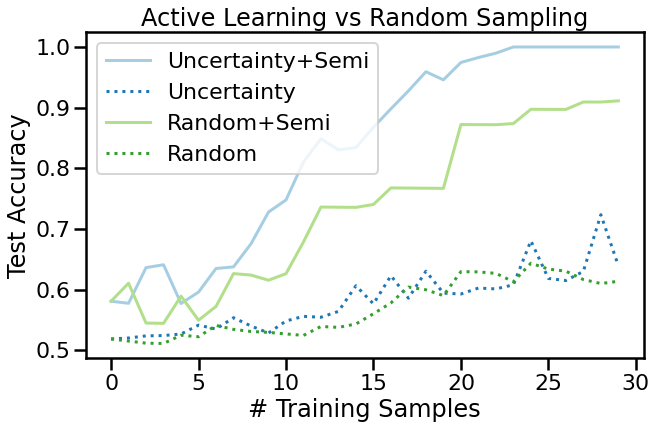

In [42]:
plt.figure(figsize=(10,6))
ax = plt.axes()
ax.set_prop_cycle('color',[plt.cm.Paired(i) for i in np.linspace(0, 1, 12)])
for o in options: # For each sampling option
    plt.plot(semi_errors[o],label=o+'+Semi')
    plt.plot(errors[o],':',label=o)
plt.legend()
plt.xlabel("# Training Samples")
plt.ylabel("Test Accuracy")
plt.title("Active Learning vs Random Sampling")
plt.show()

## Questions to think about and discuss

1. How does Semi-Supervised learning (using both Uncertainty and Random Sampling) compare to the non-semi-supervised cases you saw above?
2. In what ways does the use of Uncertainty Sampling + Semi-Supervised sampling change the location of sampled data points, compared to uncertainy sampling by itself?
3. How does Active + Semi-Supervised learning perform on Dataset 3, relative to just Active Learning by itself on Dataset 3? Why does it perform so differently?
4. Is Active + Semi-Supervised learning always better than either approach by itself? What happens in Dataset 4 (Moons + Gaussian)?

In [ ]:
#LabelSpreading?